In [1]:
import numpy as np
import tifffile
import glob
import os

from reco_helper import reconstruct_one_slice, get_spectrum

from matplotlib import pyplot as plt
%matplotlib inline

from tqdm.auto import tqdm

In [ ]:
proj_before = tifffile.imread('/mnt/HD-LSDF/Xenopus/2021_11_Xenopus/Vergleichsmessungen_NN/Xenopus_13_6p25_ms_exp_750_proj/radios_corrected/0.tif')
proj_after = tifffile.imread('/mnt/HD-LSDF/Xenopus/2021_11_Xenopus/Vergleichsmessungen_NN/Xenopus_13_6p25_ms_exp_750_proj/radios_corrected/postprocessed_0.tif')

In [2]:
reco_after = tifffile.memmap('/mnt/HD-LSDF/Xenopus/2021_11_Xenopus/Vergleichsmessungen_NN/Xenopus_13_6p25_ms_exp_750_proj/proc-rec-slices.tif')
reco_after2 = tifffile.memmap('/mnt/HD-LSDF/Xenopus/2021_11_Xenopus/Vergleichsmessungen_NN/Xenopus_13_6p25_ms_exp_750_proj/gen2_slices.tif')
reco_before = tifffile.memmap('/mnt/HD-LSDF/Xenopus/2021_11_Xenopus/Vergleichsmessungen_NN/Xenopus_13_6p25_ms_exp_750_proj/slices.tif')

In [43]:
proj_before.shape, proj_after.shape, reco_after.shape, reco_before.shape

((751, 2016, 2016), (751, 2016, 2016), (2016, 2016, 2016), (2016, 2016, 2016))

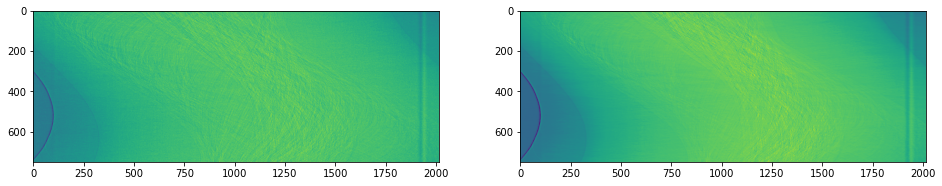

In [44]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 10))
ax1.imshow(before[:, 1200])
ax2.imshow(after[:, 1200])
plt.show()

In [37]:
reco_after = reconstruct_one_slice(np.moveaxis(after[:, 1000:1002, 85:], 1, 0), n_proj=751)

reconstructing channels:   0%|          | 0/2 [00:00<?, ?it/s]

In [38]:
reco_before = reconstruct_one_slice(np.moveaxis(before[:, 1000:1002, 85:], 1, 0), n_proj=751)

reconstructing channels:   0%|          | 0/2 [00:00<?, ?it/s]

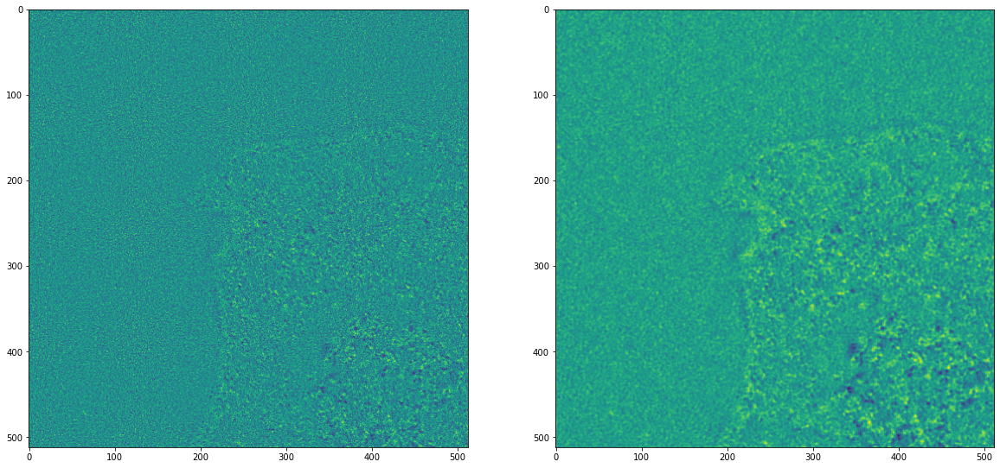

In [18]:
s = 512
z = 700
dy = 900
dx = 500

fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(20, 10))
ax2.imshow(reco_after2[z, dy:dy+s, dx:dx+s])
ax1.imshow(reco_before[z, dy:dy+s, dx:dx+s])
plt.show()

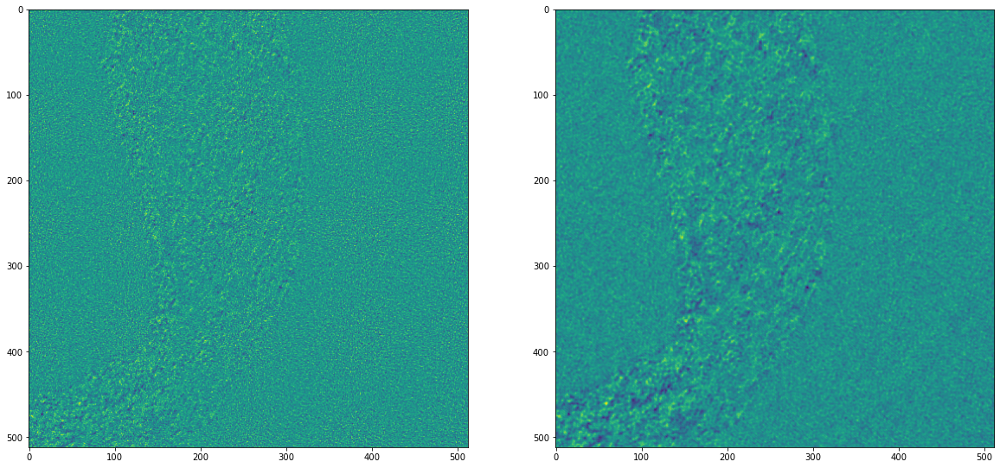

In [7]:
dz = 1200
s = 512
dy = 1200
dx = 1300

fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(20, 10))
ax2.imshow(reco_after2[dz, dy:dy+s, dx:dx+s])
ax1.imshow(reco_before[dz, dy:dy+s, dx:dx+s])
plt.show()

In [6]:
%%time
a = tifffile.imread('/mnt/HD-LSDF/Xenopus/2021_11_Xenopus/Vergleichsmessungen_NN/Xenopus_13_6p25_ms_exp_750_proj/rec-proc_slices.tif')

CPU times: user 9.14 ms, sys: 41.9 s, total: 41.9 s
Wall time: 1min 29s


In [9]:
%%time
b = tifffile.imread('/mnt/HD-LSDF/Xenopus/2021_11_Xenopus/Vergleichsmessungen_NN/Xenopus_13_6p25_ms_exp_750_proj/proc-rec-slices.tif')

CPU times: user 8.37 ms, sys: 38.3 s, total: 38.3 s
Wall time: 1min 30s


In [13]:
%%time
c = tifffile.imread('/mnt/HD-LSDF/Xenopus/2021_11_Xenopus/Vergleichsmessungen_NN/Xenopus_13_6p25_ms_exp_750_proj/slices.tif')

CPU times: user 13.5 ms, sys: 14.4 s, total: 14.4 s
Wall time: 14.4 s


In [4]:
a.mean()

-7.736246e-05

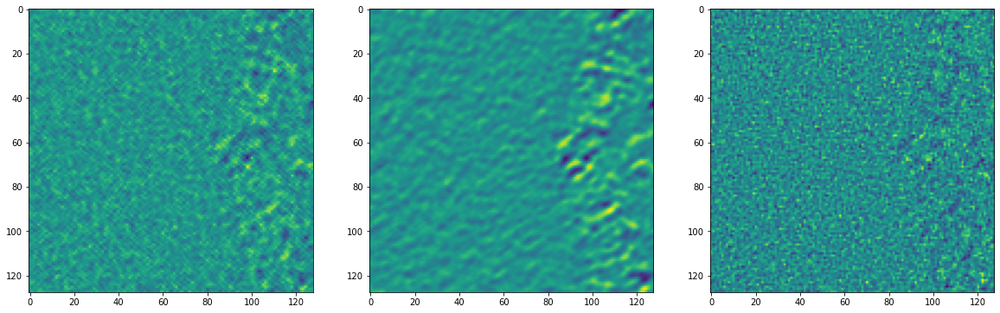

In [18]:
dz = 1200
s = 128
dy = 1200
dx = 1300

fig, (ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=(20, 10))
ax1.imshow(a[dz, dy:dy+s, dx:dx+s])
ax2.imshow(b[dz, dy:dy+s, dx:dx+s])
ax3.imshow(b[dz, dy:dy+s, dx:dx+s] - c[dz, dy:dy+s, dx:dx+s])
plt.show()

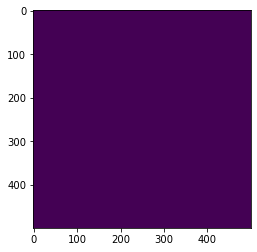

In [64]:
plt.imshow(a[1000, 1000:1500, 1000:1500])

In [2]:
from src.loaders import generic_loaders

In [3]:
import yaml

In [4]:
with open('training_configs/dataset/gatherers/xeno_reco_verg_4.yaml') as f:
    gatherer_config = yaml.safe_load(f)
with open('training_configs/dataset/datasets/n2s_05_both_reco.yaml') as f:
    dataset_config = yaml.safe_load(f) 

In [5]:
dldr = generic_loaders(gatherer_config, dataset_config, 42)

In [6]:
btch = dldr[0]['train'].__iter__().__next__()

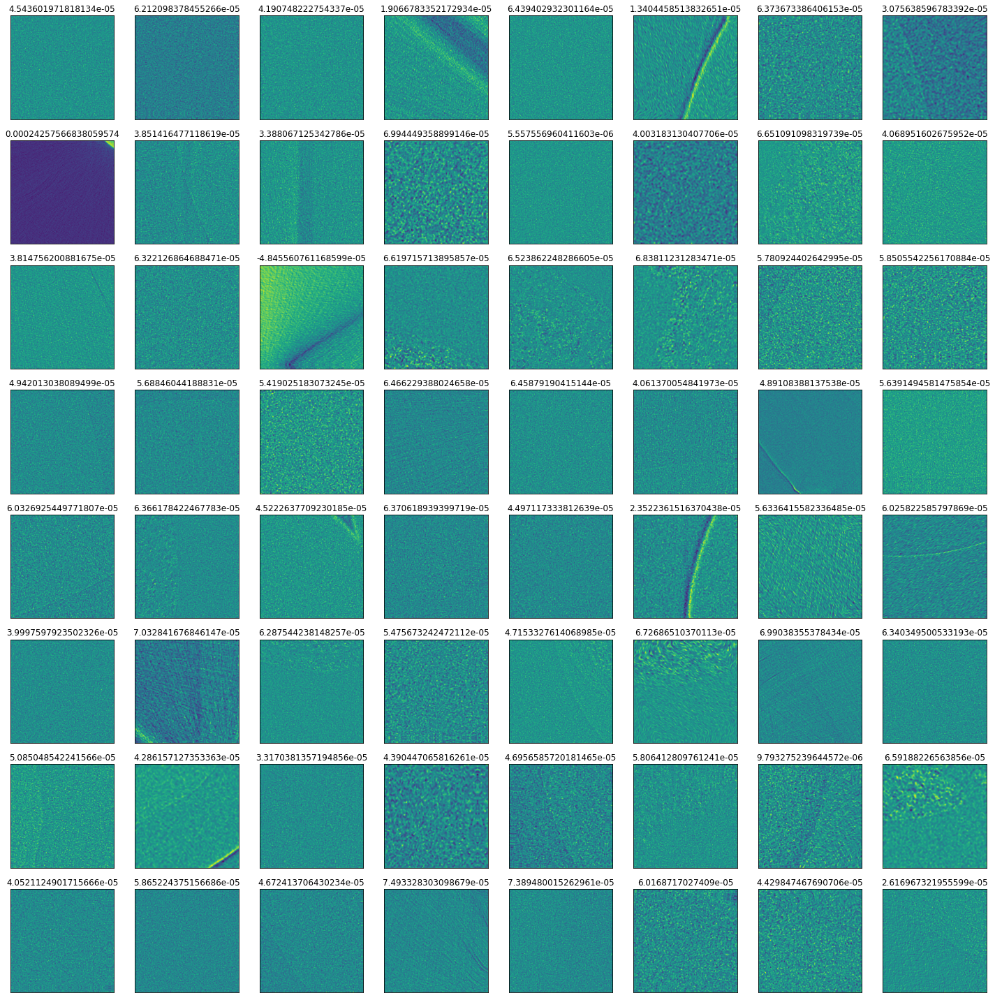

In [7]:
fig, axes = plt.subplots(ncols=8, nrows=8, figsize=(20, 20))
for i in range(len(btch[0])):
    cax = axes[i // 8][i%8]
    cax.imshow(btch[0][i, 0])
    cax.set_xticks([])
    cax.set_yticks([])
    cax.set_title(float(btch[0][i, 0].mean()))
plt.tight_layout()
plt.show()

In [94]:
btch_tst = dldr[0]['valid'].__iter__().__next__()

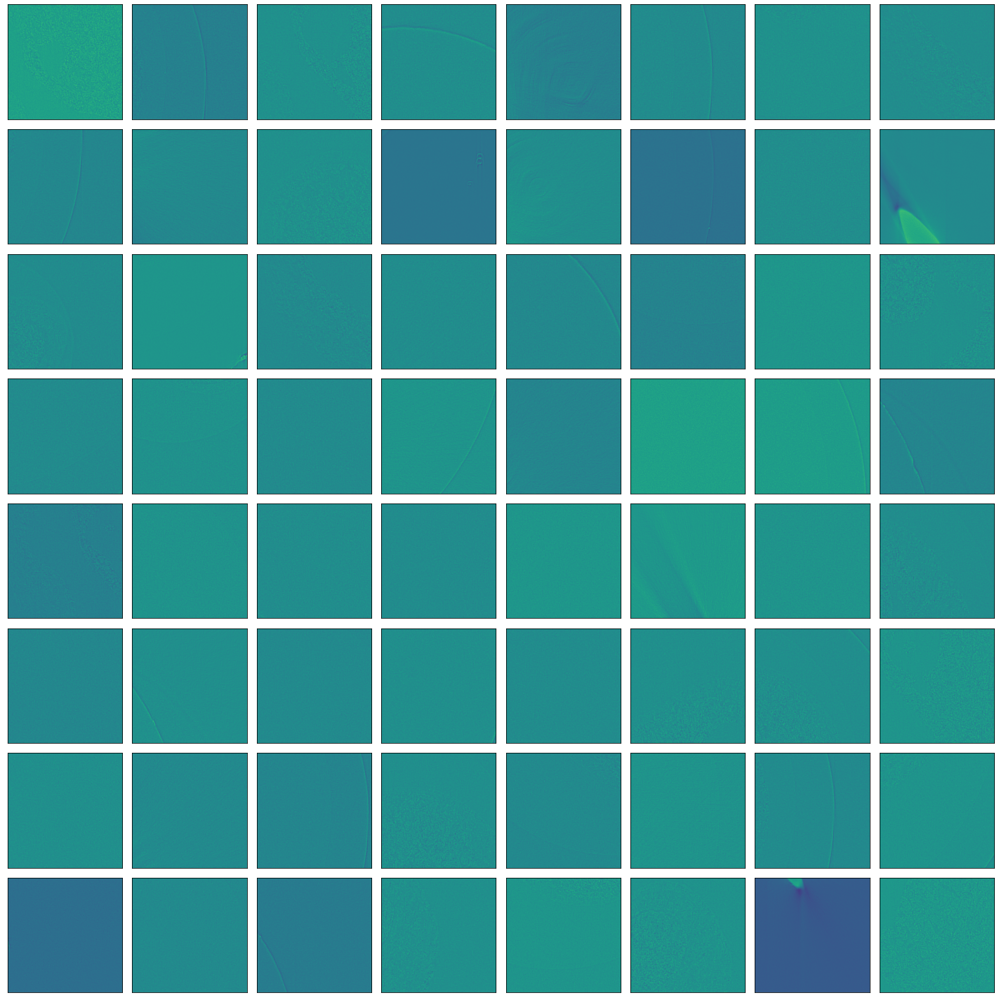

In [98]:
fig, axes = plt.subplots(ncols=8, nrows=8, figsize=(20, 20))
for i in range(64):
    cax = axes[i // 8][i%8]
    cax.imshow(btch_tst[1][i, 0])
    cax.set_xticks([])
    cax.set_yticks([])
plt.tight_layout()
plt.show()

In [105]:
btch_tst[0].mean(), btch_tst[1].mean()

(tensor(6.3635e-05), tensor(3.1828e-05))

In [106]:
btch[0].mean(), btch[1].mean()

(tensor(0.0720), tensor(0.0720))

In [113]:
with open('training_configs/dataset/gatherers/xeno_radio_verg_4.yaml') as f:
    gatherer_config = yaml.safe_load(f)
with open('training_configs/dataset/datasets/n2s_05_both.yaml') as f:
    dataset_config = yaml.safe_load(f) 

In [114]:
dldr = generic_loaders(gatherer_config, dataset_config, 42)

In [115]:
btch = dldr[0]['train'].__iter__().__next__()

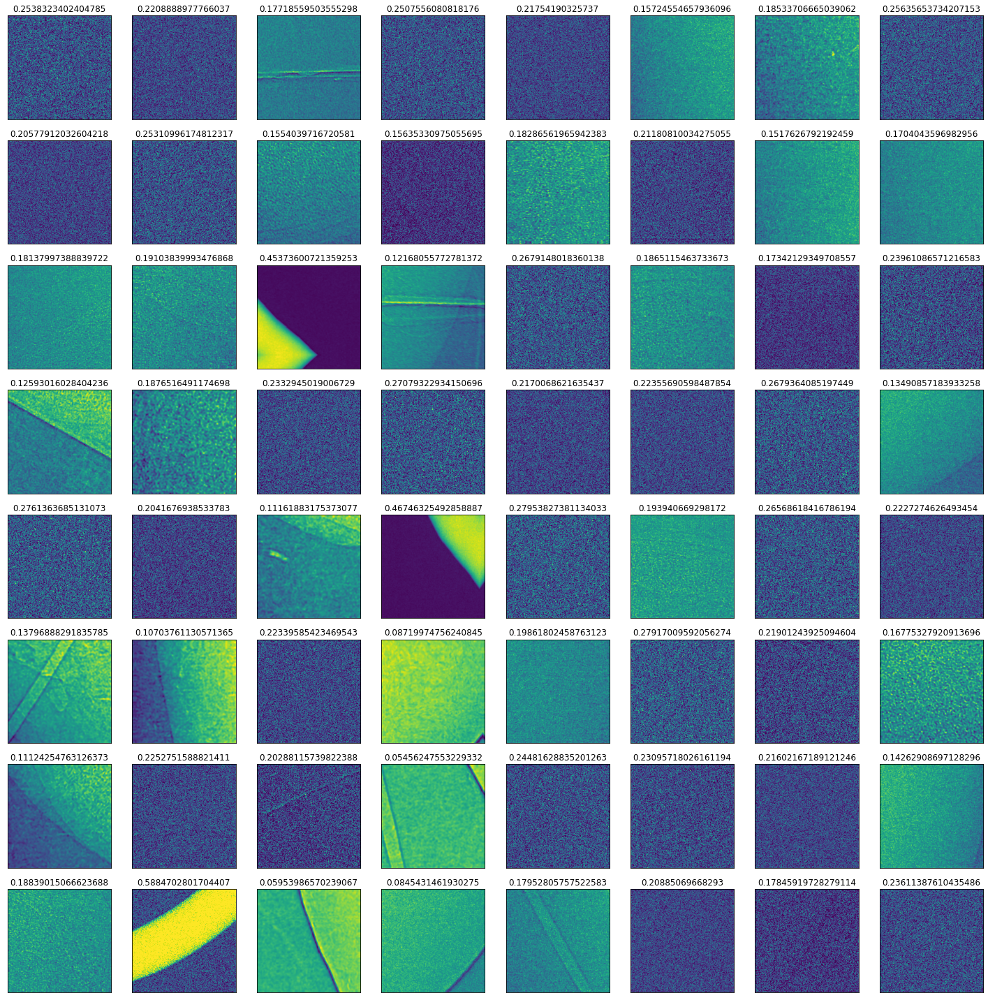

In [116]:
fig, axes = plt.subplots(ncols=8, nrows=8, figsize=(20, 20))
for i in range(len(btch[0])):
    cax = axes[i // 8][i%8]
    cax.imshow(btch[0][i, 0])
    cax.set_xticks([])
    cax.set_yticks([])
    cax.set_title(float(btch[0][i, 0].mean()))
plt.tight_layout()
plt.show()

In [4]:
with open('training_configs/dataset/gatherers/xeno_reco_verg_4_2gen.yaml') as f:
    gatherer_config = yaml.safe_load(f)
with open('training_configs/dataset/datasets/n2n_2gen_reco.yaml') as f:
    dataset_config = yaml.safe_load(f) 

In [5]:
dldr = generic_loaders(gatherer_config, dataset_config, 42)

In [10]:
%%time
btch = dldr[0]['valid'].__iter__().__next__()

CPU times: user 212 ms, sys: 1.41 s, total: 1.63 s
Wall time: 1min 28s


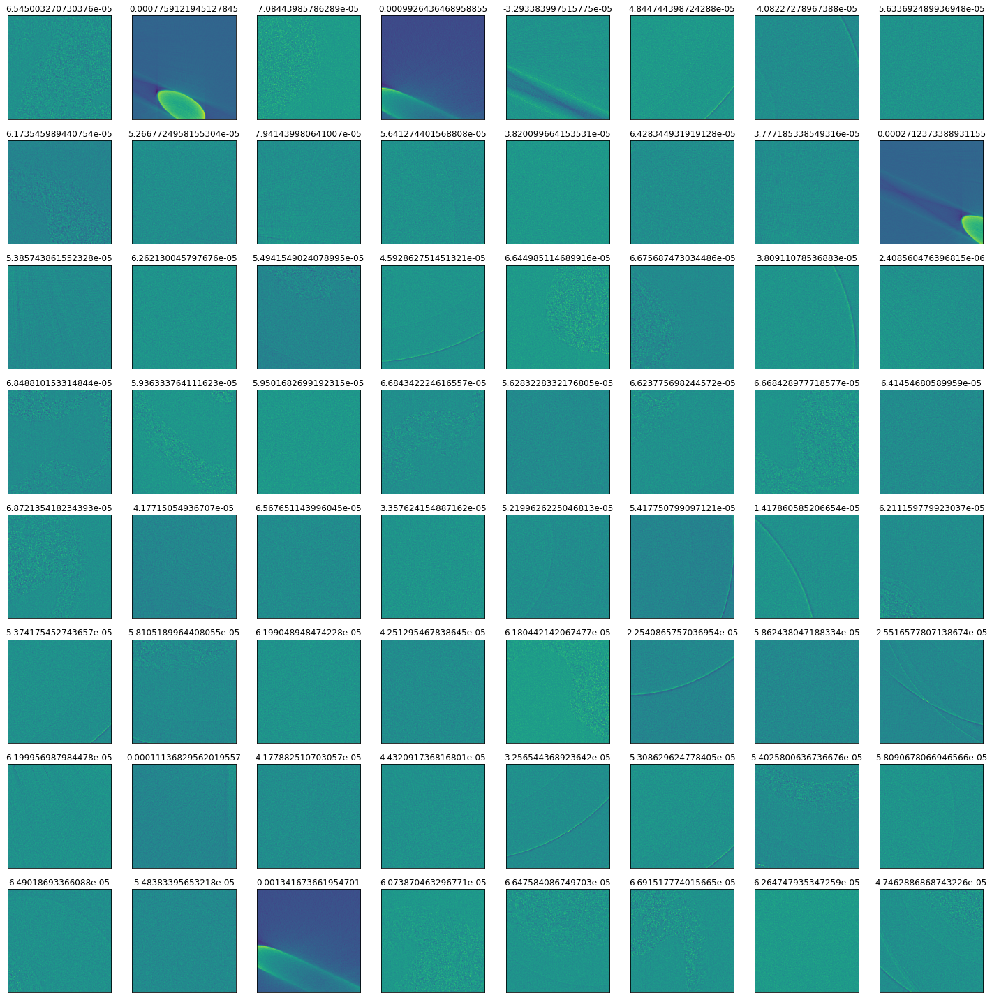

CPU times: user 3.21 s, sys: 49.1 ms, total: 3.26 s
Wall time: 3.25 s


In [12]:
%%time
fig, axes = plt.subplots(ncols=8, nrows=8, figsize=(20, 20))
for i in range(64):
    cax = axes[i // 8][i%8]
    cax.imshow(btch[0][i, 0])
    cax.set_xticks([])
    cax.set_yticks([])
    cax.set_title(float(btch[0][i, 0].mean()))
plt.tight_layout()
plt.show()

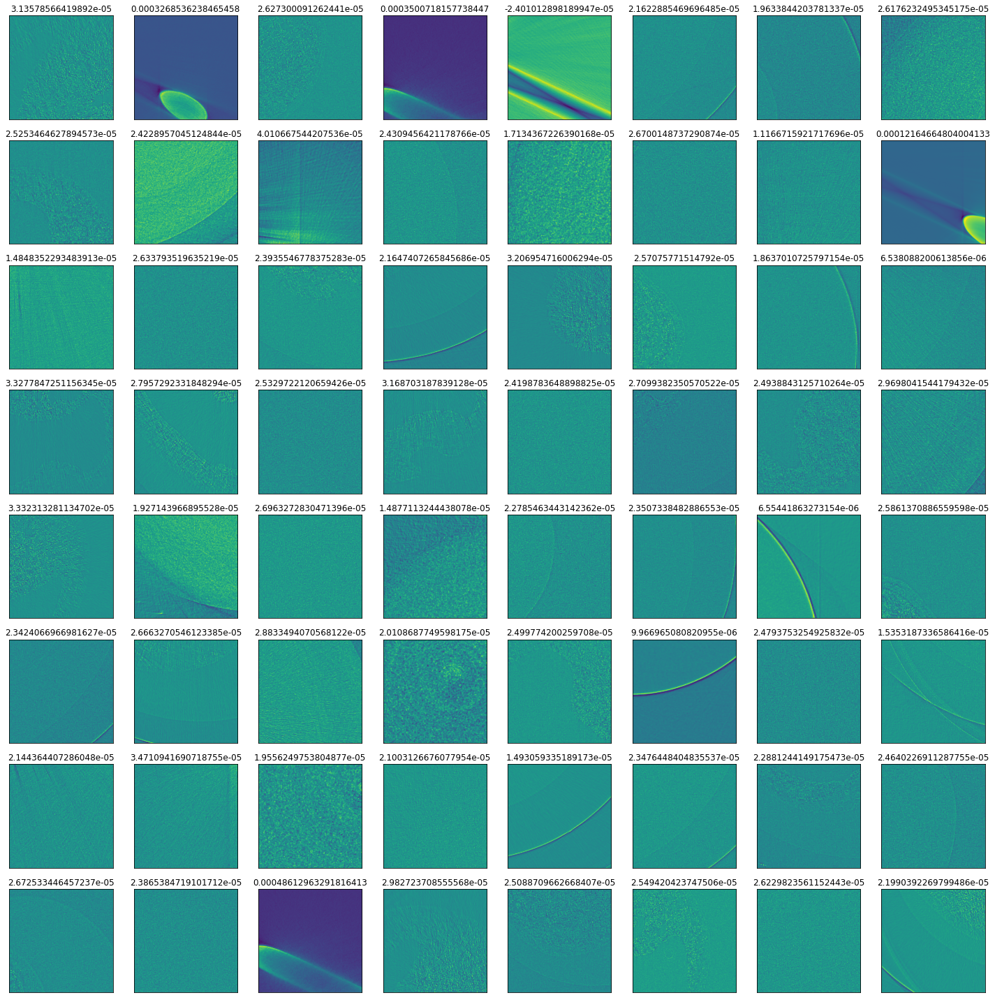

CPU times: user 3.34 s, sys: 51.8 ms, total: 3.39 s
Wall time: 3.38 s


In [13]:
%%time
fig, axes = plt.subplots(ncols=8, nrows=8, figsize=(20, 20))
for i in range(64):
    cax = axes[i // 8][i%8]
    cax.imshow(btch[1][i, 0])
    cax.set_xticks([])
    cax.set_yticks([])
    cax.set_title(float(btch[1][i, 0].mean()))
plt.tight_layout()
plt.show()